In [1]:
import os, sys, glob, shutil
import argparse
import json
import yaml
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm.notebook import tqdm
from pprint import pprint
import torchaudio
import torch
from IPython.display import Audio, display

In [2]:
%cd "D:\Schoolwork\TERM 3\WORK\visual_prosody"

D:\Schoolwork\TERM 3\WORK\visual_prosody


In [3]:
val_mcdv5_df = pd.read_csv(r".\jupyter_walkthrough\metrics\MCD_0707a_1M2.csv")
train_mcdv5_df = pd.read_csv(r".\jupyter_walkthrough\metrics\MCD_0707a_1M2_train.csv")

In [4]:
val_mcdv5_df.nsmallest(5, 'MCD_recon')

,Unnamed: 0,uid,MCD_recon,MCD_gt
2370,2370,0e4ae9e1-640b-45d1-90b2-17b4e941322d,7.243025,10.131522
107,107,a6d4dbc4-969d-4819-af85-f3b3cb56195e,7.783217,13.009296
444,444,af8de660-f916-4a2c-92ac-4e767436ed2c,8.237475,8.663778
373,373,1b66fe95-6176-4ee1-98ba-984c9bfe1f5f,8.497393,8.395654
1749,1749,2667f8d5-30e0-44da-80ce-27df506a8a82,8.592734,10.184369


Text(0.5, 0, 'MCD_recon val')

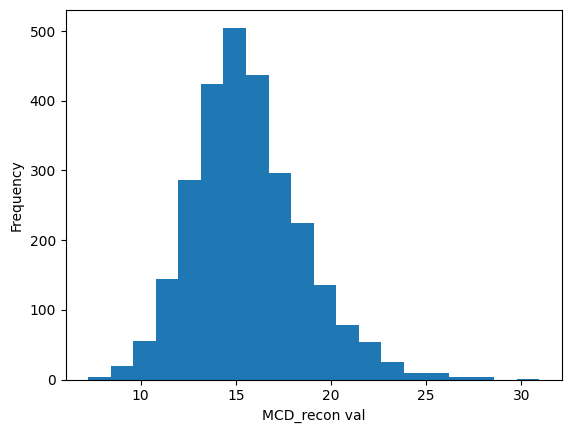

In [57]:
val_mcdv5_df['MCD_recon'].plot(kind='hist', bins=20)
plt.xlabel('MCD_recon val')

Text(0.5, 0, 'MCD_recon train')

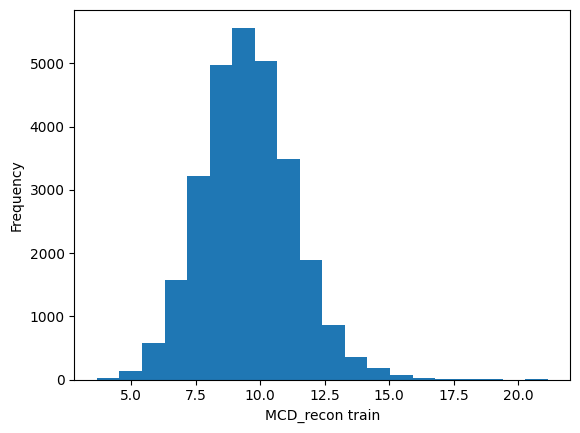

In [58]:
train_mcdv5_df['MCD_recon'].plot(kind='hist', bins=20)
plt.xlabel('MCD_recon train')

In [11]:
val_mcdv5_df['MCD_recon'].describe()

count    2715.000000
mean       15.638039
std         2.909718
min         7.243025
25%        13.668043
50%        15.339301
75%        17.251632
max        30.934711
Name: MCD_recon, dtype: float64

In [12]:
train_mcdv5_df['MCD_recon'].describe()

count    28010.000000
mean         9.539996
std          1.769873
min          3.679867
25%          8.338755
50%          9.478001
75%         10.652657
max         21.148561
Name: MCD_recon, dtype: float64

In [13]:
val_mcdv5_df['MCD_recon'].quantile(0.9)

19.423199399999994

In [14]:
def get_topk_closet(target, k, df, col='MCD_recon'):
    return df.iloc[(df[col]-target).abs().argsort()[:k]]

In [45]:
def display_audio(uid, split):
    sampled_uid = uid
    # print(f"uid: {sampled_uid}")
    
    if split == 'train':
        wav_path = os.path.join(r".\output\0707a\result\Ego4D_final_v5\train\wav\synthesized", f"{sampled_uid}.wav")
        gt_path = os.path.join(r".\raw_data\Ego4D_final_v5\train\Ego4D_final_v5", f"{sampled_uid}.wav")
        mel_path = os.path.join(r".\output\0707a\result\Ego4D_final_v5\train\mel\syn", f"{sampled_uid}.pt")
    elif split == 'val':
        wav_path = os.path.join(r".\output\0707a\result\Ego4D_final_v5\wav\synthesized", f"{sampled_uid}.wav")
        gt_path = os.path.join(r".\raw_data\Ego4D_final_v5\val\Ego4D_final_v5", f"{sampled_uid}.wav")
        mel_path = os.path.join(r".\output\0707a\result\Ego4D_final_v5\mel\syn", f"{sampled_uid}.pt")

    display(Audio(filename=wav_path, rate=22050))
    display(Audio(filename=gt_path, rate=22050))
    # mel_np = torch.load(mel_path).numpy()
    # print(mel_np.shape)
    # nparray_mel_to_svg(mel_np, "/content/test_v6.svg")

In [46]:
def display_gt_audio(uid, split):
    sampled_uid = uid
    # print(f"uid: {sampled_uid}")
    if split == 'train':
        wav_path = os.path.join(r".\raw_data\Ego4D_final_v6\train\Ego4D_final_v5", f"{sampled_uid}.wav")
    elif split == 'val':
        wav_path = os.path.join(r".\raw_data\Ego4D_final_v6\val\Ego4D_final_v6", f"{sampled_uid}.wav")
    display(Audio(filename=wav_path, rate=22050))


def display_gt_audio_v56(uid, split):
    sampled_uid = uid
    # print(f"uid: {sampled_uid}")
    if split == 'train':
        wav_path = os.path.join(r".\raw_data\Ego4D_final_v5\train\Ego4D_final_v5", f"{sampled_uid}.wav")
        wav_path_v6 = os.path.join(r".\raw_data\Ego4D_final_6\train\Ego4D_final_v6", f"{sampled_uid}.wav")
    elif split == 'val':
        wav_path = os.path.join(r".\raw_data\Ego4D_final_v5\val\Ego4D_final_v5", f"{sampled_uid}.wav")
        wav_path_v6 = os.path.join(r".\raw_data\Ego4D_final_v6\val\Ego4D_final_v6", f"{sampled_uid}.wav")
    display(Audio(filename=wav_path, rate=22050))
    try:
        display(Audio(filename=wav_path_v5, rate=22050))
    except:
        print('v6 not exist')

In [47]:
def nparray_mel_to_svg(mel_array, svg_path):
    vmin = -12.5
    vmax = 0.0
    spec = mel_array
    fig = plt.figure(figsize=(5,2), tight_layout=True) #(20,4)
    ax = fig.add_subplot()
    image = ax.imshow(spec, cmap="jet", origin="lower",
                aspect="equal", interpolation="none", vmax=vmax, vmin=vmin)
    fig.colorbar(mappable=image, orientation='vertical', ax=ax, shrink=0.5)

    # plt.savefig(svg_path, format="svg", bbox_inches='tight')
    plt.plot()

In [51]:
def display_topk_closet(target, k, split, df):
    print(f"Top {k} utt with MCD closet to {target}. [{split} set]\n")
    selection = get_topk_closet(target, k, df=df)
    for uid, mcd in zip(selection['uid'].values, selection['MCD_recon'].values):
        print(f"UID: {uid}")
        print(f"###  MCD: {mcd}")
        display_audio(uid=uid, split=split)

In [49]:
def display_topk_closet_gt(target, k, split, df):
    print(f"Top {k} utt with MCD closet to {target}. [{split} set]\n")
    selection = get_topk_closet(target, k, df=df)
    for uid, mcd in zip(selection['uid'].values, selection['MCD_recon'].values):
        print(f"UID: {uid}")
        print(f"###  MCD: {mcd}")
        display_gt_audio(uid=uid, split=split)

def display_topk_closet_gt_v56(target, k, split, df):
    print(f"Top {k} utt with MCD closet to {target}. [{split} set]\n")
    selection = get_topk_closet(target, k, df=df)
    for uid, mcd in zip(selection['uid'].values, selection['MCD_recon'].values):
        print(f"UID: {uid}")
        print(f"###  MCD: {mcd}")
        display_gt_audio_v56(uid=uid, split=split)

In [33]:
display_topk_closet_gt(20, 20, 'val', val_mcdv5_df)

Top 20 utt with MCD closet to 20. [val set]

UID: d76d44d7-01d0-46d6-81df-0f1a4848ae17
###  MCD: 19.993536


UID: 2ee0d405-89f1-4f8a-84bb-3322895dad62
###  MCD: 20.007925


UID: ddad52ce-e842-46ba-b0a8-bac782479c54
###  MCD: 20.015202


UID: 3cf61de9-8557-4f90-bdb9-18ac42711342
###  MCD: 19.977337


UID: b8573ce2-c1f3-41f0-a20f-59c26a603cbf
###  MCD: 20.023052


UID: d23fdd77-12ea-4946-b109-afb17514bf87
###  MCD: 20.02428


UID: 0bacecf1-931b-422e-949e-ba5902ca407e
###  MCD: 19.973824


UID: 9ba19155-2765-40e5-84aa-763dad0fee55
###  MCD: 19.967169


UID: d6fc5516-a3ab-4489-87bc-7f4ca4ffed36
###  MCD: 19.962318


UID: 36968f14-a1bd-4092-9c78-7db8dae218a1
###  MCD: 19.95837


UID: 00bda9b7-c6d2-472b-8785-8ec0c6d68c54
###  MCD: 20.043497


UID: 497726ac-425c-4a35-ad24-bb290434b615
###  MCD: 19.946606


UID: 1be5f9e5-781d-4d4f-af76-9ff0e04588c4
###  MCD: 20.056255


UID: 24c5c688-01f3-4426-922e-95e0ed82a972
###  MCD: 19.938747


UID: be9ee47d-7a20-4e11-8b8b-1a115f6844ea
###  MCD: 20.064209


UID: 637c82ac-0a09-43dc-9601-cb4c64cccbd2
###  MCD: 19.93153


UID: 7506fb6d-04c2-4e37-be2f-2544186195aa
###  MCD: 19.917263


UID: 8867d91e-620a-4611-960a-6b3b1ae1ec52
###  MCD: 19.914103


UID: ec40d323-50fd-43a8-81d4-78daea68ec98
###  MCD: 20.087605


UID: 44813e74-bbe5-4241-af5a-858c908adddd
###  MCD: 20.0927


In [35]:
display_topk_closet_gt(10, 20, 'val', val_mcdv5_df)

Top 20 utt with MCD closet to 10. [val set]

UID: adfbe29a-88e7-41a2-952a-db018f29c848
###  MCD: 9.9703


UID: 96787234-e336-499f-ac55-31d9ca6fc927
###  MCD: 9.94965


UID: 56ea6364-1185-4a20-8603-de9e1a0042fd
###  MCD: 10.067753


UID: 7af6bfcb-f3e8-4d86-995f-fe0d1c6b11cd
###  MCD: 10.098295


UID: 15b9952c-cbd0-458d-ab30-af2742dd627d
###  MCD: 10.135297


UID: 42983c44-5191-423e-b125-07b54b46f1ab
###  MCD: 9.854919


UID: fc819bd9-1aff-4bdf-9ec2-62c29bb369e5
###  MCD: 9.849513


UID: 2fcc7673-c266-4040-8fc7-efbffa723844
###  MCD: 10.177834


UID: 301ecc65-2332-49f9-a6f0-cc453c81a174
###  MCD: 10.20106


UID: 2be7ad89-505b-47f0-beeb-4e1a2385b70a
###  MCD: 10.20748


UID: 4a8139d7-8ca3-4b91-ae1f-dd21baffefb4
###  MCD: 10.209314


UID: 65eef46b-af80-404a-8c75-2ee134ee9758
###  MCD: 10.220307


UID: ade9bc02-46e2-460e-aed1-4fcf55c004f4
###  MCD: 10.225033


UID: 0bc0e5d1-d562-41d3-8bc3-b9e3a0c3705f
###  MCD: 10.277897


UID: 9e9bf357-bce7-46b8-a084-fb3eeabe3b7c
###  MCD: 10.286049


UID: 729e3650-4cd6-4ffe-8ce5-e3a00a7baa3b
###  MCD: 9.71355


UID: 883c268b-9491-4264-accf-768b6adbad43
###  MCD: 10.290769


UID: f915779a-025a-45c8-b3f7-81949da6d0f3
###  MCD: 10.310344


UID: 91052dd9-7384-42ef-81b7-0022c4d84795
###  MCD: 10.317672


UID: e2098ef0-deb8-4da0-9199-bf386c8b956c
###  MCD: 9.681923


In [60]:
display_topk_closet(17, 20, 'val', val_mcdv5_df)

Top 20 utt with MCD closet to 17. [val set]

UID: 0f8d1c9f-e06d-4b3a-ae01-010b7a2e9899
###  MCD: 17.001715


UID: 6b051774-99b5-404a-a882-cc774f866422
###  MCD: 16.998016


UID: 1f670237-0bde-4fa6-a0ec-81cf7c1a6558
###  MCD: 16.997175


UID: 4d1316b3-ff21-4c7d-9789-43747a1b8ca7
###  MCD: 16.995062


UID: caedd39a-ddde-4a22-bf4b-7874f23e754d
###  MCD: 17.005253


UID: 06a67705-f5a8-4ff1-9e3e-bb105f97af34
###  MCD: 17.005974


UID: 551052e5-d910-4a6b-9a55-9a7c276c59e2
###  MCD: 16.993982


UID: 3d4d6cc0-4765-416c-aef9-bd107d6baa38
###  MCD: 16.993809


UID: 63391d5c-dc64-426a-82b5-7814bffa0a0f
###  MCD: 16.993591


UID: ec3d72c9-e8de-46d3-b07e-afe85c0e25bc
###  MCD: 16.992739


UID: fe4e832a-1e55-4347-85ae-29de41256662
###  MCD: 16.9875


UID: 07607397-c74a-490b-b145-9bd474f7b22b
###  MCD: 17.018713


UID: e728ffe4-984c-4645-b066-02796f6067d3
###  MCD: 17.019346


UID: 0048639e-8a86-4321-a906-f17c2e49742f
###  MCD: 17.019878


UID: 26392b5d-3e99-4a30-a373-c45638550d07
###  MCD: 16.97945


UID: 302ddb10-0529-4e1d-914d-73bacc3a867b
###  MCD: 17.021868


UID: 6f52cf72-6136-4809-b82f-11126f847819
###  MCD: 16.976686


UID: ffc09302-1833-46b3-a42b-0e4a8c52906f
###  MCD: 16.975048


UID: 39e37bfe-bad3-48e9-9dc8-c5f02a11cf39
###  MCD: 16.974607


UID: f0ef89a1-4a8c-4593-a5ab-d871c4b911dd
###  MCD: 16.974234


In [53]:
display_topk_closet(20, 20, 'val', val_mcdv5_df)

Top 20 utt with MCD closet to 20. [val set]

UID: d76d44d7-01d0-46d6-81df-0f1a4848ae17
###  MCD: 19.993536


UID: 2ee0d405-89f1-4f8a-84bb-3322895dad62
###  MCD: 20.007925


UID: ddad52ce-e842-46ba-b0a8-bac782479c54
###  MCD: 20.015202


UID: 3cf61de9-8557-4f90-bdb9-18ac42711342
###  MCD: 19.977337


UID: b8573ce2-c1f3-41f0-a20f-59c26a603cbf
###  MCD: 20.023052


UID: d23fdd77-12ea-4946-b109-afb17514bf87
###  MCD: 20.02428


UID: 0bacecf1-931b-422e-949e-ba5902ca407e
###  MCD: 19.973824


UID: 9ba19155-2765-40e5-84aa-763dad0fee55
###  MCD: 19.967169


UID: d6fc5516-a3ab-4489-87bc-7f4ca4ffed36
###  MCD: 19.962318


UID: 36968f14-a1bd-4092-9c78-7db8dae218a1
###  MCD: 19.95837


UID: 00bda9b7-c6d2-472b-8785-8ec0c6d68c54
###  MCD: 20.043497


UID: 497726ac-425c-4a35-ad24-bb290434b615
###  MCD: 19.946606


UID: 1be5f9e5-781d-4d4f-af76-9ff0e04588c4
###  MCD: 20.056255


UID: 24c5c688-01f3-4426-922e-95e0ed82a972
###  MCD: 19.938747


UID: be9ee47d-7a20-4e11-8b8b-1a115f6844ea
###  MCD: 20.064209


UID: 637c82ac-0a09-43dc-9601-cb4c64cccbd2
###  MCD: 19.93153


UID: 7506fb6d-04c2-4e37-be2f-2544186195aa
###  MCD: 19.917263


UID: 8867d91e-620a-4611-960a-6b3b1ae1ec52
###  MCD: 19.914103


UID: ec40d323-50fd-43a8-81d4-78daea68ec98
###  MCD: 20.087605


UID: 44813e74-bbe5-4241-af5a-858c908adddd
###  MCD: 20.0927


In [61]:
display_topk_closet(30, 10, 'train', train_mcdv5_df)

Top 10 utt with MCD closet to 30. [train set]

UID: 55b72a13-9e0a-4e0e-9289-fd14ab24e627
###  MCD: 21.148561


UID: 797cc95a-9062-4bc6-b28d-d3100a6ad817
###  MCD: 20.88679


UID: b69e0da9-dd12-4394-8727-c75a3c15d9fb
###  MCD: 20.741346


UID: a40fce22-6afc-42b6-9101-306fd14ca3d6
###  MCD: 19.676283


UID: 5248ebe3-4905-4799-82b2-410205c8509a
###  MCD: 19.167067


UID: 7c9cbeaa-a750-4a13-837e-14eaf7b3f45d
###  MCD: 18.679321


UID: cfcd5a13-c553-4061-a0fb-6b36a6606b87
###  MCD: 18.362883


UID: ad2fde8a-a518-485a-9157-1907b0a6a62a
###  MCD: 18.156567


UID: a053ebbc-8c44-48ab-a1f2-a63409fcff1d
###  MCD: 17.9018


UID: 3ebd8aab-afaf-4ad6-8100-f8ccf309d6ca
###  MCD: 17.788244


In [64]:
display_topk_closet(13, 20, 'train', train_mcdv5_df)

Top 20 utt with MCD closet to 13. [train set]

UID: ae1508a9-ad32-4e6c-b216-1e8294e9487b
###  MCD: 12.998523


UID: f3775eb5-9b0a-4772-ac18-9fa42d6a8374
###  MCD: 12.99829


UID: 6a0bdb2a-2e3c-4fb2-b811-14e7644bb2d4
###  MCD: 12.997852


UID: 5d194ad0-a088-4da6-904a-bc8930be6652
###  MCD: 13.002964


UID: 0518eccd-4bdc-479b-98f0-6912dd4aa9d7
###  MCD: 12.996131


UID: 39eade5a-56f0-44a5-8bce-896d9d171572
###  MCD: 13.005061


UID: 9aeaefb8-d868-421a-8728-99531efeeba3
###  MCD: 13.005575


UID: a5a8d593-7521-40ba-993d-31f004d05e55
###  MCD: 12.993388


UID: ad5b34dc-c7eb-4e05-84d8-38e814a3f0e2
###  MCD: 12.992731


UID: 9d172287-d8c5-4db2-8871-8590a74e4789
###  MCD: 12.991858


UID: a9e85610-b4be-4f72-9643-b7570dfd7e20
###  MCD: 12.991422


UID: 6b0dbe5c-9ac8-42d9-8de8-ee0ba012c64b
###  MCD: 13.009942


UID: cb1766c1-0668-4f8e-b5d5-52f0d47ae3ec
###  MCD: 12.988164


UID: 4efa482b-8cb9-456d-9572-d2c68720fb5c
###  MCD: 12.987619


UID: 3e97a04a-f703-4ceb-ba8b-3564e383ebcf
###  MCD: 13.012482


UID: 780c4814-801c-4b24-82e0-1f897bff3ba0
###  MCD: 12.987088


UID: d6f98ece-38b4-42a8-98ee-8786dc646c2b
###  MCD: 12.987076


UID: 7f78d724-efb2-4c81-836c-8da95358d30c
###  MCD: 13.013625


UID: cbbbd2f8-aaa9-407e-a817-ac85c11f84f6
###  MCD: 12.985384


UID: 6b23c520-9d0f-450b-bf3d-103a44b0a2aa
###  MCD: 12.984313


In [62]:
display_topk_closet(11.5, 20, 'train', train_mcdv5_df)

Top 20 utt with MCD closet to 11.5. [train set]

UID: e73813ea-39fb-4e76-9cf6-7e8767a49a75
###  MCD: 11.499983


UID: 539be199-ae88-49cf-94a5-6f31c01e9d79
###  MCD: 11.500025


UID: cb441409-652d-49d9-b4bb-05a331f98671
###  MCD: 11.499634


UID: 45999288-4804-46e5-9b8b-22fabb26d3e7
###  MCD: 11.499437


UID: 73a8b8de-8755-4d61-8cbb-b80a840263cd
###  MCD: 11.500576


UID: 37920731-b4cd-48e9-9e92-3276a9a1e9ac
###  MCD: 11.499329


UID: e3f7a283-71a9-42c6-beba-efde8e594917
###  MCD: 11.500833


UID: c9b2794b-03f8-4b40-b3b8-7c1268754a77
###  MCD: 11.500966


UID: 92657e9d-eea7-44bb-8189-733254e5dc59
###  MCD: 11.501016


UID: 7213e074-582e-4b0a-9bd1-818fa352e0f9
###  MCD: 11.498613


UID: 70f53cf3-d009-41d9-b891-95402d6af590
###  MCD: 11.498604


UID: e72fce74-488b-4c7a-92fe-8b6fa1ca3d4c
###  MCD: 11.501941


UID: 1203c2bd-e98f-42be-b9dc-a8373076d50d
###  MCD: 11.498055


UID: 94297912-aa95-458e-84b3-631ce1bc3820
###  MCD: 11.498037


UID: b324e140-93d5-4a35-98bb-5e18a717a5a0
###  MCD: 11.50204


UID: a7b6469a-123c-4929-91de-d0813a4dc62f
###  MCD: 11.502102


UID: 54fc6328-3647-4e80-9f14-5a5ab731468b
###  MCD: 11.497846


UID: a680732e-df79-4962-a85f-faad8da8ada5
###  MCD: 11.502271


UID: b7743cb9-7b12-446a-b0c0-1a97b4e3a89c
###  MCD: 11.497577


UID: 110929d5-c8cb-4800-9c54-5376caa9c5db
###  MCD: 11.497482


In [65]:
val_mcdv5_df['MCD_recon'].describe()

count    2715.000000
mean       15.638039
std         2.909718
min         7.243025
25%        13.668043
50%        15.339301
75%        17.251632
max        30.934711
Name: MCD_recon, dtype: float64

In [71]:
val_mcdv5_df[val_mcdv5_df['MCD_recon']<18]['MCD_recon'].describe()

count    2190.000000
mean       14.567666
std         1.922926
min         7.243025
25%        13.278347
50%        14.726014
75%        16.028863
max        17.994747
Name: MCD_recon, dtype: float64

In [68]:
train_mcdv5_df['MCD_recon'].describe()

count    28010.000000
mean         9.539996
std          1.769873
min          3.679867
25%          8.338755
50%          9.478001
75%         10.652657
max         21.148561
Name: MCD_recon, dtype: float64

In [70]:
train_mcdv5_df[train_mcdv5_df['MCD_recon']<12.5]['MCD_recon'].describe()

count    26617.000000
mean         9.328640
std          1.528748
min          3.679867
25%          8.268437
50%          9.369438
75%         10.449199
max         12.499408
Name: MCD_recon, dtype: float64